<a href="https://colab.research.google.com/github/kayneh-dev/IAT360-ComputerVisionProject/blob/Kayne-Branch/IAT360_ComputerVisionProject.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

1. Connect to Google Drive first:

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


2. Import libraries and packages

In [2]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
import cv2
import seaborn as sns
import glob
import xml.etree.ElementTree as ET
from PIL import Image
import os
import shutil
from pathlib import Path

In [3]:
#@title Install dependencies
!pip install -q ultralytics
!pip install -q scikit-learn pandas tqdm

print('Installed ultralytics and helpers')

Installed ultralytics and helpers


3. Define paths/hierarchies

In [6]:
#Draft 1

BASE_DIR = '/content/drive/MyDrive/IAT360_ComputerVision_Project'
TRAIN_DIR = os.path.join(BASE_DIR, 'Images_Train_var2')
TEST_DIR = os.path.join(BASE_DIR, 'Images_Test')
OUT_DIR = '/content/drive/MyDrive/IAT360_ComputerVision_Project/yolo_classify_dataset'


os.makedirs(OUT_DIR, exist_ok=True)


print('Train dir:', TRAIN_DIR)
print('Test dir:', TEST_DIR)

# Weather/time folder structure
weather_dirs = [d for d in sorted(os.listdir(TRAIN_DIR)) if os.path.isdir(os.path.join(TRAIN_DIR, d))]
print("Detected weather folders:", weather_dirs)

classes = []
class_paths = []

for wdir in weather_dirs:
    w_path = os.path.join(TRAIN_DIR, wdir)
    time_dirs = [t for t in sorted(os.listdir(w_path)) if os.path.isdir(os.path.join(w_path, t))]
    for tdir in time_dirs:
        wname = ''.join([c for c in wdir if not c.isdigit()]).lower()  # Cloudy01 → cloudy
        tname = ''.join([c for c in tdir if not c.isdigit()]).lower()  # Afternoon01 → afternoon
        class_name = f"{wname}_{tname}"
        classes.append(class_name)
        class_paths.append(os.path.join(w_path, tdir))

print(f"Detected {len(classes)} total classes:")
print(classes)

Train dir: /content/drive/MyDrive/IAT360_ComputerVision_Project/Images_Train_var2
Test dir: /content/drive/MyDrive/IAT360_ComputerVision_Project/Images_Test
Detected weather folders: ['Cloudy01', 'Foggy02', 'Rainy03', 'Snowy04', 'Sunny05']
Detected 26 total classes:
['cloudy_afternoon', 'cloudy_dawn', 'cloudy_dusk', 'cloudy_morning', 'cloudy_night', 'foggy_afternoon', 'foggy_dawn', 'foggy_dusk', 'foggy_morning', 'foggy_night', 'rainy_afternoon', 'rainy_dawn', 'rainy_dusk', 'rainy_morning', 'rainy_night', 'snowy_afternoon', 'snowy_dawn', 'snowy_dusk', 'snowy_morning', 'snowy_night', 'sunny_.ipynb_checkpoints', 'sunny_afternoon', 'sunny_dawn', 'sunny_dusk', 'sunny_morning', 'sunny_night']


In [8]:
TRAIN_DIR = '/content/drive/MyDrive/IAT360_ComputerVision_Project/Images_Train_var2'
TEST_DIR  = '/content/drive/MyDrive/IAT360_ComputerVision_Project/Images_Test'
OUT_DIR   = '/content/drive/MyDrive/IAT360_ComputerVision_Project/yolo_classify_outputs'

os.makedirs(OUT_DIR, exist_ok=True)

print('TRAIN_DIR:', TRAIN_DIR)
print('TEST_DIR :', TEST_DIR)
print('OUT_DIR  :', OUT_DIR)

assert os.path.exists(TRAIN_DIR), 'TRAIN_DIR does not exist. Check path A.'
assert os.path.exists(TEST_DIR),  'TEST_DIR does not exist. Check path A.'

TRAIN_DIR: /content/drive/MyDrive/IAT360_ComputerVision_Project/Images_Train_var2
TEST_DIR : /content/drive/MyDrive/IAT360_ComputerVision_Project/Images_Test
OUT_DIR  : /content/drive/MyDrive/IAT360_ComputerVision_Project/yolo_classify_outputs


Inspect current train structure

In [9]:
print('Top-level items in TRAIN_DIR:')
for item in sorted(os.listdir(TRAIN_DIR))[:20]:
    print(' -', item)

def count_nested_folders(base):
    count = 0
    for w in os.listdir(base):
        wp = os.path.join(base, w)
        if not os.path.isdir(wp):
            continue
        for t in os.listdir(wp):
            tp = os.path.join(wp, t)
            if os.path.isdir(tp):
                count += 1
    return count

nested_count = count_nested_folders(TRAIN_DIR)
print(f'Estimated nested subfolders under TRAIN_DIR: {nested_count}')

Top-level items in TRAIN_DIR:
 - cloudy_afternoon
 - cloudy_dawn
 - cloudy_dusk
 - cloudy_morning
 - cloudy_night
 - foggy_afternoon
 - foggy_dawn
 - foggy_dusk
 - foggy_morning
 - foggy_night
 - rainy_afternoon
 - rainy_dawn
 - rainy_dusk
 - rainy_morning
 - rainy_night
 - snowy_afternoon
 - snowy_dawn
 - snowy_dusk
 - snowy_morning
 - snowy_night
Estimated nested subfolders under TRAIN_DIR: 0


Build class list & visualize class distribution

Detected 25 classes:
 ['cloudy_afternoon', 'cloudy_dawn', 'cloudy_dusk', 'cloudy_morning', 'cloudy_night', 'foggy_afternoon', 'foggy_dawn', 'foggy_dusk', 'foggy_morning', 'foggy_night', 'rainy_afternoon', 'rainy_dawn', 'rainy_dusk', 'rainy_morning', 'rainy_night', 'snowy_afternoon', 'snowy_dawn', 'snowy_dusk', 'snowy_morning', 'snowy_night', 'sunny_afternoon', 'sunny_dawn', 'sunny_dusk', 'sunny_morning', 'sunny_night']

Images per class:
cloudy_afternoon     : 20
cloudy_dawn          : 20
cloudy_dusk          : 20
cloudy_morning       : 20
cloudy_night         : 20
foggy_afternoon      : 20
foggy_dawn           : 20
foggy_dusk           : 20
foggy_morning        : 20
foggy_night          : 20
rainy_afternoon      : 20
rainy_dawn           : 20
rainy_dusk           : 20
rainy_morning        : 20
rainy_night          : 20
snowy_afternoon      : 20
snowy_dawn           : 20
snowy_dusk           : 20
snowy_morning        : 20
snowy_night          : 20
sunny_afternoon      : 20
sunny_dawn  

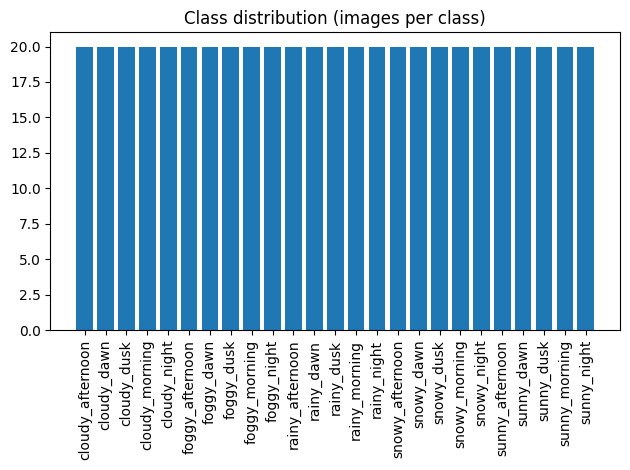

In [12]:
import os
from collections import Counter
import matplotlib.pyplot as plt

class_folders = [d for d in sorted(os.listdir(TRAIN_DIR)) if os.path.isdir(os.path.join(TRAIN_DIR, d)) and '_' in d]
classes = class_folders
print(f'Detected {len(classes)} classes:\n', classes)

img_exts = ('.jpg','.jpeg','.png','.bmp')
counts = {}
for cls in classes:
    cdir = os.path.join(TRAIN_DIR, cls)
    n = sum(1 for f in os.listdir(cdir) if f.lower().endswith(img_exts))
    counts[cls] = n

print('\nImages per class:')
for k,v in counts.items():
    print(f"{k:20s} : {v}")

plt.figure()
plt.bar(range(len(counts)), list(counts.values()))
plt.xticks(range(len(counts)), list(counts.keys()), rotation=90)
plt.title('Class distribution (images per class)')
plt.tight_layout()
plt.show()

Train YOLOv8 classification

In [13]:
from ultralytics import YOLO

model = YOLO('yolov8n-cls.pt')
print('Starting training...')
model.train(
    data=TRAIN_DIR,
    epochs=12,
    batch=16,
    imgsz=224,
    name='weather_time_cls',
    augment=True
)
print('Training complete. Weights in ./runs/classify/weather_time_cls/')

Starting training...
Ultralytics 8.3.221 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=True, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/IAT360_ComputerVision_Project/Images_Train_var2, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=12, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=224, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n-cls.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=weather_time_cls3, nbs=64, nms=False, opset=None, optimize=False, optimi

Predict on test images & export CSV (with weather/time columns)

In [18]:
!ls /content/runs/classify/weather_time_cls3/weights

best.pt  last.pt


In [20]:
import os, pandas as pd
from tqdm import tqdm
from ultralytics import YOLO

# Confirm correct run folder!
best_model_path = '/content/runs/classify/weather_time_cls3/weights/best.pt'
assert os.path.exists(best_model_path), "Model weights not found. Check 'runs/classify/' folder"

model = YOLO(best_model_path)

img_exts = ('.jpg','.jpeg','.png','.bmp')
rows = []

for f in tqdm(os.listdir(TEST_DIR)):
    if not f.lower().endswith(img_exts):
        continue
    p = os.path.join(TEST_DIR, f)
    r = model.predict(p, verbose=False)[0]
    cls_id = r.probs.top1            # Updated API call
    cls_name = model.names[cls_id]
    if '_' in cls_name:
        weather, time = cls_name.split('_', 1)
    else:
        weather, time = cls_name, ''
    rows.append({'filename': f, 'predicted_class': cls_name, 'weather': weather, 'time': time})

df = pd.DataFrame(rows)
csv_path = os.path.join(OUT_DIR, 'test_predictions.csv')
df.to_csv(csv_path, index=False)
print("Saved predictions to:", csv_path)
df.head()


100%|██████████| 60/60 [02:18<00:00,  2.31s/it]

Saved predictions to: /content/drive/MyDrive/IAT360_ComputerVision_Project/yolo_classify_outputs/test_predictions.csv


,filename,predicted_class,weather,time
0,0060.png,sunny_afternoon,sunny,afternoon
1,0059.png,cloudy_morning,cloudy,morning
2,0058.png,cloudy_morning,cloudy,morning
3,0057.png,cloudy_morning,cloudy,morning
4,0056.png,cloudy_morning,cloudy,morning


Classification Report and Confusion Matrix

Evaluation complete!

 Classification Report:

                  precision    recall  f1-score   support

cloudy_afternoon       0.80      1.00      0.89         8
     cloudy_dawn       0.50      1.00      0.67         7
     cloudy_dusk       0.60      0.86      0.71         7
  cloudy_morning       1.00      0.38      0.55         8
    cloudy_night       0.89      1.00      0.94         8
 foggy_afternoon       1.00      0.83      0.91         6
      foggy_dawn       1.00      1.00      1.00         7
      foggy_dusk       0.88      0.88      0.88         8
   foggy_morning       1.00      0.71      0.83         7
     foggy_night       0.78      1.00      0.88         7
 rainy_afternoon       1.00      0.50      0.67         8
      rainy_dawn       0.60      0.38      0.46         8
      rainy_dusk       1.00      0.71      0.83         7
   rainy_morning       0.50      0.71      0.59         7
     rainy_night       1.00      0.86      0.92         7
 snowy_afternoon       0

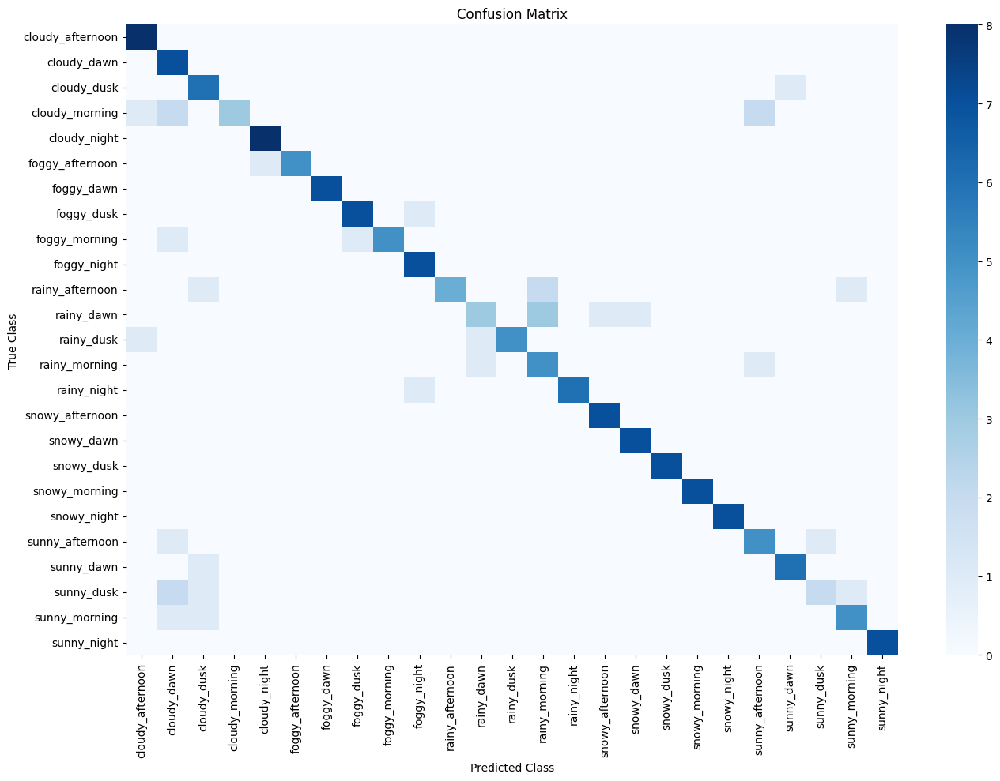

In [21]:
import os
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, classification_report
from ultralytics import YOLO

# Confirm correct trained model path
best_model_path = '/content/runs/classify/weather_time_cls3/weights/best.pt'
model = YOLO(best_model_path)

# Auto–validation split from YOLO training
VAL_DIR = TRAIN_DIR + '_split/val'
img_exts = ('.jpg', '.jpeg', '.png', '.bmp')

true_labels = []
pred_labels = []
file_records = []

# Detect classes from folder names inside TRAIN_DIR
classes = sorted([d for d in os.listdir(TRAIN_DIR) if "_" in d])

for cls_index, cls_name in enumerate(classes):
    cls_folder = os.path.join(VAL_DIR, cls_name)
    if not os.path.exists(cls_folder):
        continue

    for f in os.listdir(cls_folder):
        if f.lower().endswith(img_exts):
            path = os.path.join(cls_folder, f)
            result = model.predict(path, verbose=False)[0]
            pred_idx = result.probs.top1

            true_labels.append(cls_index)
            pred_labels.append(pred_idx)
            file_records.append((path, cls_index, pred_idx))

print("Evaluation complete!")

# Print metrics
print("\n Classification Report:\n")
print(classification_report(true_labels, pred_labels, target_names=classes))

# Confusion Matrix
cm = confusion_matrix(true_labels, pred_labels)

plt.figure(figsize=(14, 10))
sns.heatmap(cm, cmap="Blues", xticklabels=classes, yticklabels=classes)
plt.xlabel("Predicted Class")
plt.ylabel("True Class")
plt.title("Confusion Matrix")
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

Worked vs Failed


 Correct predictions: 146
 Incorrect predictions: 33

Examples of Correct Predictions
True: rainy_afternoon, Predicted: rainy_afternoon


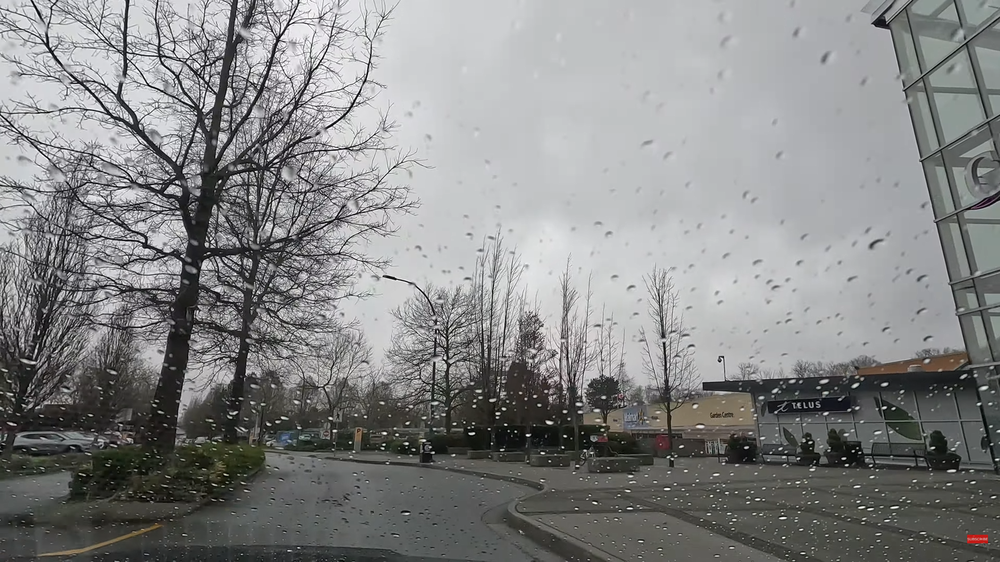

True: sunny_afternoon, Predicted: sunny_afternoon


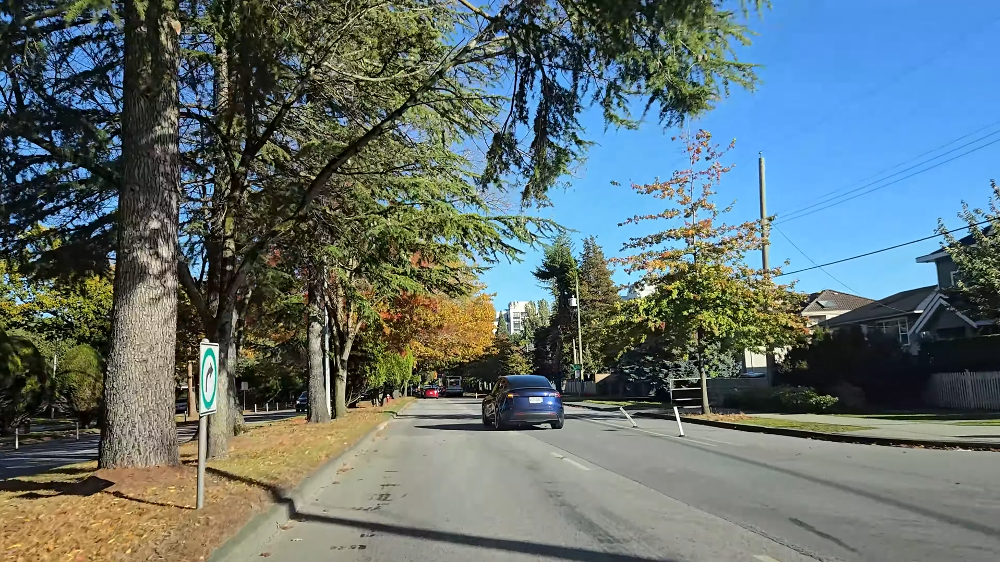

True: snowy_afternoon, Predicted: snowy_afternoon


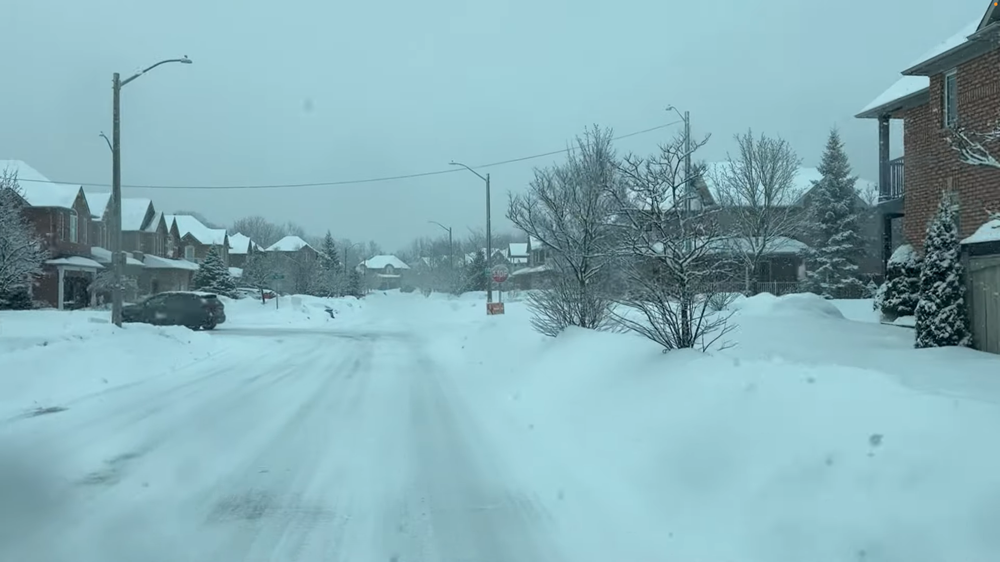

True: foggy_night, Predicted: foggy_night


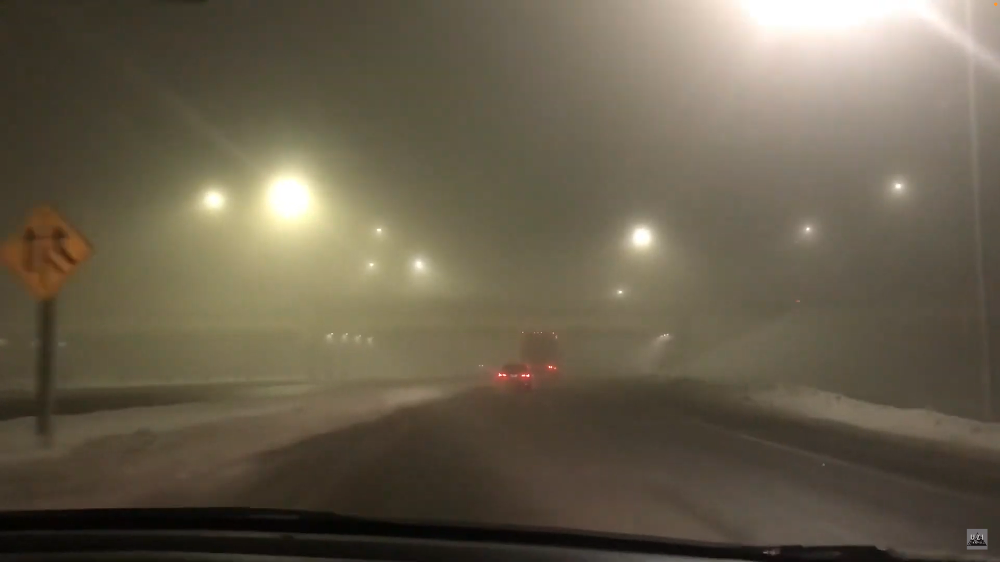

True: cloudy_dawn, Predicted: cloudy_dawn


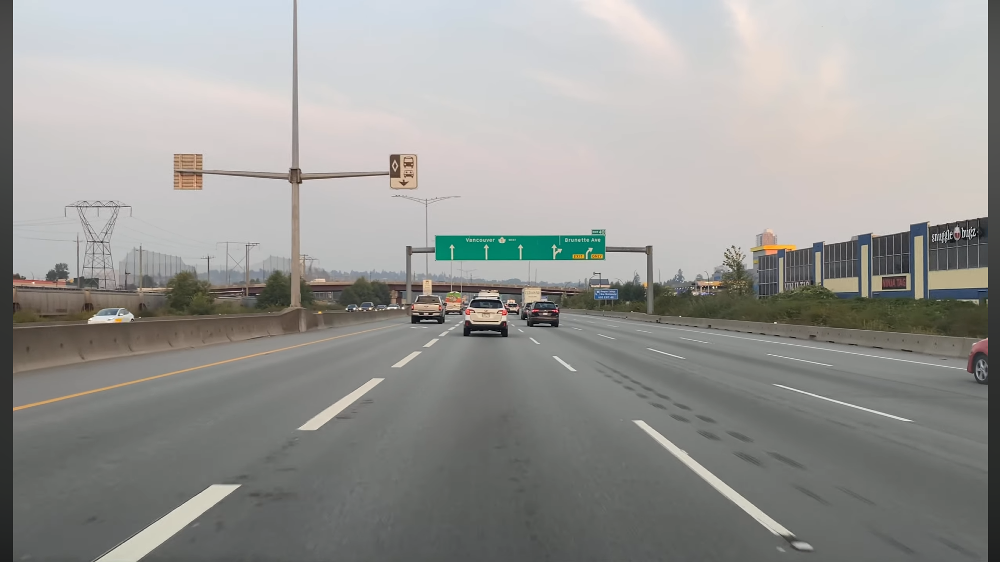


Examples of Incorrect Predictions
True: rainy_dusk, Predicted: rainy_dawn


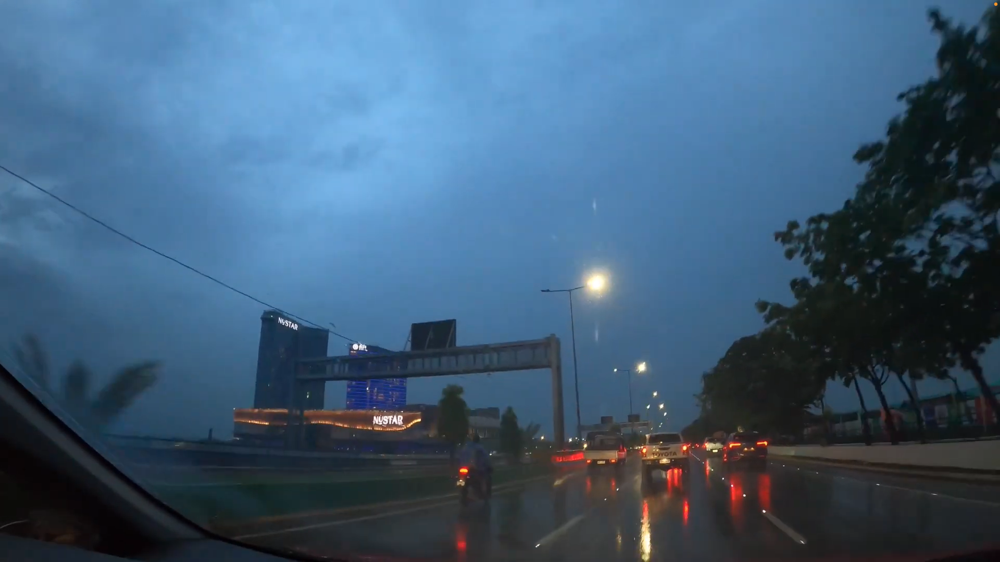

True: cloudy_morning, Predicted: cloudy_afternoon


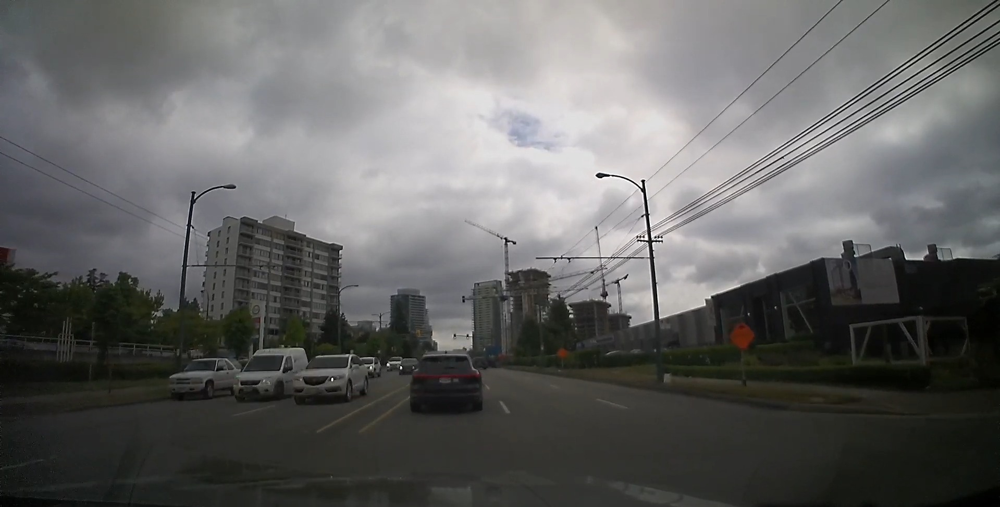

True: cloudy_dusk, Predicted: sunny_dawn


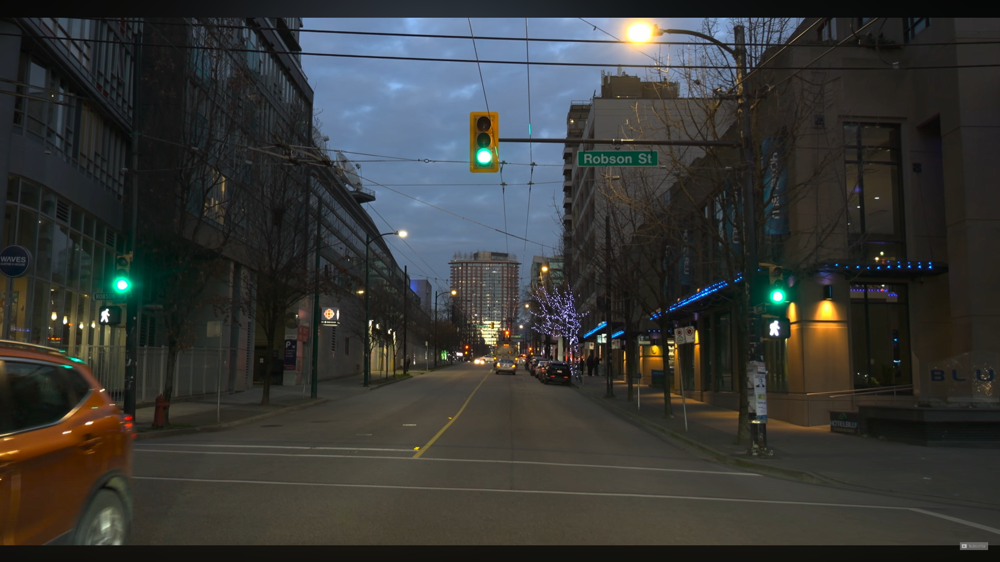

True: sunny_dusk, Predicted: sunny_morning


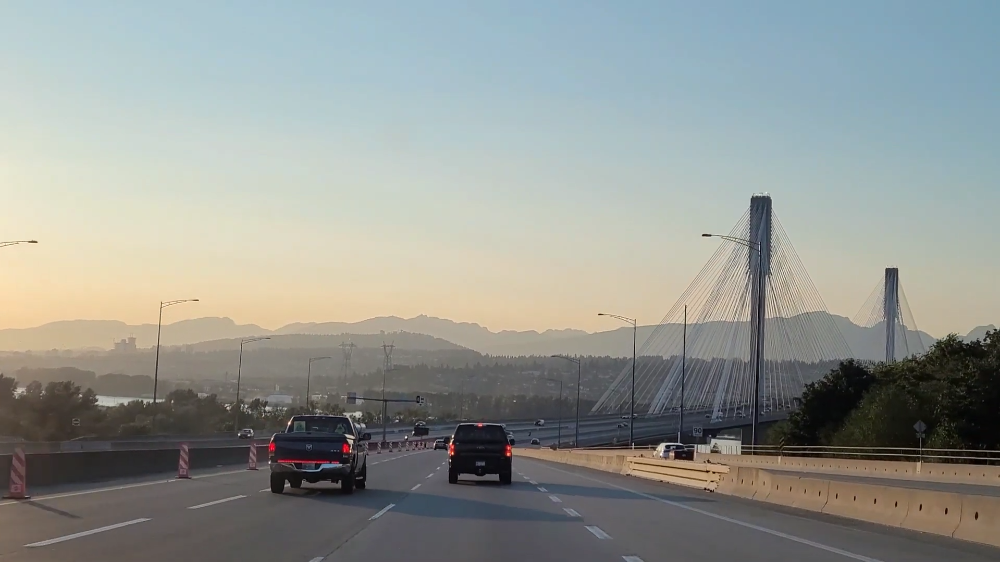

True: sunny_morning, Predicted: cloudy_dusk


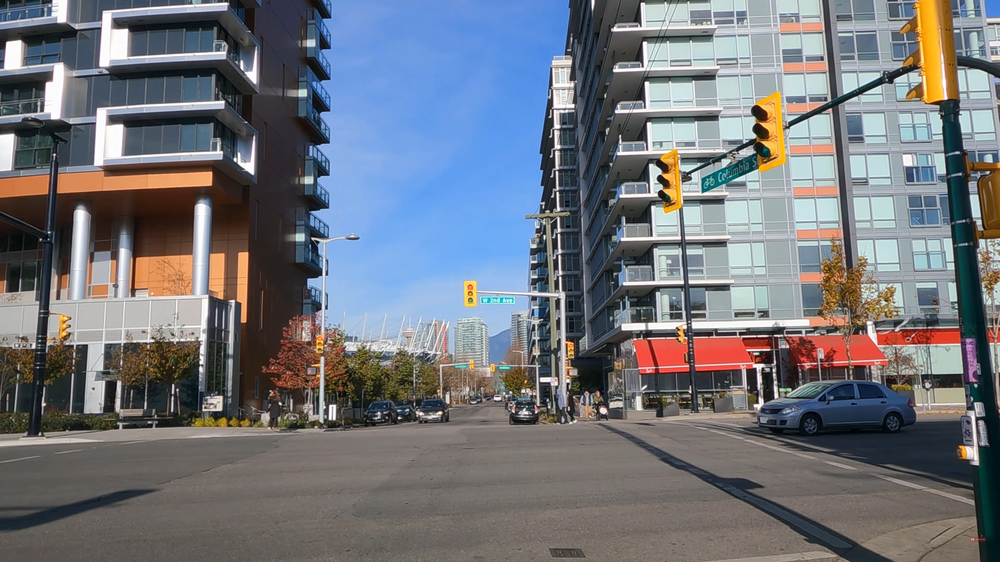

In [22]:
import random
from IPython.display import display, Image

# Separate correct vs incorrect examples
correct_samples = [(p,t) for (p,t,pred) in file_records if t == pred]
incorrect_samples = [(p,t,pred) for (p,t,pred) in file_records if t != pred]

print(f"\n Correct predictions: {len(correct_samples)}")
print(f" Incorrect predictions: {len(incorrect_samples)}")

def show_examples(examples, title):
    print("\n" + title)
    display_count = min(5, len(examples))
    for item in random.sample(examples, display_count):
        if len(item) == 2: # correct tuple form
            path, t = item
            pred = t
        else:
            path, t, pred = item
        print(f"True: {classes[t]}, Predicted: {classes[pred]}")
        display(Image(filename=path))

show_examples(correct_samples, "Examples of Correct Predictions")
show_examples(incorrect_samples, "Examples of Incorrect Predictions")
